# Exploratory Data Analysis

In [6]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
from IPython.display import display,HTML

In [12]:
df = pd.read_csv('/survey_results_public.csv')

In [13]:
df.head()

,ResponseId,MainBranch,Employment,RemoteWork,CodingActivities,EdLevel,LearnCode,LearnCodeOnline,LearnCodeCoursesCert,YearsCode,...,TimeSearching,TimeAnswering,Onboarding,ProfessionalTech,TrueFalse_1,TrueFalse_2,TrueFalse_3,SurveyLength,SurveyEase,ConvertedCompYearly
0,1,None of these,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,I am a developer by profession,"Employed, full-time",Fully remote,Hobby;Contribute to open-source projects,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Too long,Difficult,NaN
2,3,"I am not primarily a developer, but I write co...","Employed, full-time","Hybrid (some remote, some in-person)",Hobby,"Master’s degree (M.A., M.S., M.Eng., MBA, etc.)",Books / Physical media;Friend or family member...,Technical documentation;Blogs;Programming Game...,NaN,14,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Appropriate in length,Neither easy nor difficult,40205.0
3,4,I am a developer by profession,"Employed, full-time",Fully remote,I don’t code outside of work,"Bachelor’s degree (B.A., B.S., B.Eng., etc.)","Books / Physical media;School (i.e., Universit...",NaN,NaN,20,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Appropriate in length,Easy,215232.0
4,5,I am a developer by profession,"Employed, full-time","Hybrid (some remote, some in-person)",Hobby,"Bachelor’s degree (B.A., B.S., B.Eng., etc.)","Other online resources (e.g., videos, blogs, f...",Technical documentation;Blogs;Stack Overflow;O...,NaN,8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Too long,Easy,NaN


In [15]:
df.shape

(73268, 79)

In [16]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [17]:
df.isnull().sum()

,0
ResponseId,0
MainBranch,0
Employment,1559
RemoteWork,14310
CodingActivities,14369
EdLevel,1697
LearnCode,1688
LearnCodeOnline,22583
LearnCodeCoursesCert,43879
YearsCode,1937


In [18]:
df.iloc[0]

,0
ResponseId,1
MainBranch,None of these
Employment,NaN
RemoteWork,NaN
CodingActivities,NaN
EdLevel,NaN
LearnCode,NaN
LearnCodeOnline,NaN
LearnCodeCoursesCert,NaN
YearsCode,NaN


In [19]:
df.drop(0, axis = 0, inplace = True)

In [20]:
df.shape

(73267, 79)

In [21]:
cols = []

for i in df.columns:
  cols.append(i)

In [22]:
len(cols)

79

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73267 entries, 1 to 73267
Data columns (total 79 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   ResponseId                      73267 non-null  int64  
 1   MainBranch                      73267 non-null  object 
 2   Employment                      71709 non-null  object 
 3   RemoteWork                      58958 non-null  object 
 4   CodingActivities                58899 non-null  object 
 5   EdLevel                         71571 non-null  object 
 6   LearnCode                       71580 non-null  object 
 7   LearnCodeOnline                 50685 non-null  object 
 8   LearnCodeCoursesCert            29389 non-null  object 
 9   YearsCode                       71331 non-null  object 
 10  YearsCodePro                    51833 non-null  object 
 11  DevType                         61302 non-null  object 
 12  OrgSize                         

In [24]:
df.drop(['VCHostingPersonal use', 'VCHostingProfessional use'], axis =1, inplace = True)

In [25]:
df.shape

(73267, 77)

In [28]:
schema = pd.read_csv('/survey_results_schema.csv', index_col = 'qname').question

In [29]:
schema.shape

(66,)

In [30]:
schema

,question
qname,
S0,"<div><span style=""font-size:19px;""><strong>Hel..."
MetaInfo,Browser Meta Info
S1,"<span style=""font-size:22px; font-family: aria..."
MainBranch,Which of the following options best describes ...
Employment,Which of the following best describes your cur...
RemoteWork,Which best describes your current work situation?
CodingActivities,Which of the following best describes the code...
S2,"<span style=""font-size:22px; font-family: aria..."
EdLevel,Which of the following best describes the high...


In [31]:
schema["Employment"]

'Which of the following best describes your current employment status?'

# Data Cleaning and Data Preprocessing

The survey responses contain a wealth of information, therefore we are going to limit our analysis to some following areas:

1) Demographics

2) Distribution of Skills

3) Employment related information

In [32]:
cols_for_da = [
 'MainBranch',
 'Employment',
 'RemoteWork',
 'CodingActivities',
 'EdLevel',
 'LearnCode',
 'LearnCodeOnline',
 'LearnCodeCoursesCert',
 'YearsCode',
 'YearsCodePro',
 'DevType',
 'OrgSize',
 'PurchaseInfluence',
 'BuyNewTool',
 'Country',
 'Currency',
 'CompTotal',
 'CompFreq',
 'LanguageHaveWorkedWith',
 'LanguageWantToWorkWith',
 'PlatformHaveWorkedWith',
 'PlatformWantToWorkWith',
 'NEWSOSites',
 'SOVisitFreq',
 'SOAccount',
 'SOPartFreq',
 'SOComm',
 'Age',
 'Gender',
 'Trans',
 'Sexuality',
 'Ethnicity',
 'Accessibility',
 'MentalHealth',
 'TBranch',
 'ICorPM',
 'WorkExp',
 'TimeSearching',
 'TimeAnswering',
 'Onboarding',
 'ProfessionalTech',
 'ConvertedCompYearly']

In [33]:
len(cols_for_da)

42

In [34]:
new_df = df[cols_for_da].copy()

In [35]:
new_df.head()

,MainBranch,Employment,RemoteWork,CodingActivities,EdLevel,LearnCode,LearnCodeOnline,LearnCodeCoursesCert,YearsCode,YearsCodePro,DevType,OrgSize,PurchaseInfluence,BuyNewTool,Country,Currency,CompTotal,CompFreq,LanguageHaveWorkedWith,LanguageWantToWorkWith,PlatformHaveWorkedWith,PlatformWantToWorkWith,NEWSOSites,SOVisitFreq,SOAccount,SOPartFreq,SOComm,Age,Gender,Trans,Sexuality,Ethnicity,Accessibility,MentalHealth,TBranch,ICorPM,WorkExp,TimeSearching,TimeAnswering,Onboarding,ProfessionalTech,ConvertedCompYearly
1,I am a developer by profession,"Employed, full-time",Fully remote,Hobby;Contribute to open-source projects,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Canada,CAD\tCanadian dollar,NaN,NaN,JavaScript;TypeScript,Rust;TypeScript,NaN,NaN,Collectives on Stack Overflow;Stack Overflow f...,Daily or almost daily,Yes,Daily or almost daily,Not sure,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"I am not primarily a developer, but I write co...","Employed, full-time","Hybrid (some remote, some in-person)",Hobby,"Master’s degree (M.A., M.S., M.Eng., MBA, etc.)",Books / Physical media;Friend or family member...,Technical documentation;Blogs;Programming Game...,NaN,14,5,Data scientist or machine learning specialist;...,20 to 99 employees,I have some influence,NaN,United Kingdom of Great Britain and Northern I...,GBP\tPound sterling,32000.0,Yearly,C#;C++;HTML/CSS;JavaScript;Python,C#;C++;HTML/CSS;JavaScript;TypeScript,NaN,NaN,Collectives on Stack Overflow;Stack Overflow;S...,Multiple times per day,Yes,Multiple times per day,Neutral,25-34 years old,Man,No,Bisexual,White,None of the above,"I have a mood or emotional disorder (e.g., dep...",No,NaN,NaN,NaN,NaN,NaN,NaN,40205.0
3,I am a developer by profession,"Employed, full-time",Fully remote,I don’t code outside of work,"Bachelor’s degree (B.A., B.S., B.Eng., etc.)","Books / Physical media;School (i.e., Universit...",NaN,NaN,20,17,"Developer, full-stack",100 to 499 employees,I have some influence,Other (please specify):,Israel,ILS\tIsraeli new shekel,60000.0,Monthly,C#;JavaScript;SQL;TypeScript,C#;SQL;TypeScript,NaN,NaN,Collectives on Stack Overflow;Stack Overflow f...,Daily or almost daily,Yes,A few times per week,"Yes, definitely",35-44 years old,Man,No,Straight / Heterosexual,White,None of the above,None of the above,No,NaN,NaN,NaN,NaN,NaN,NaN,215232.0
4,I am a developer by profession,"Employed, full-time","Hybrid (some remote, some in-person)",Hobby,"Bachelor’s degree (B.A., B.S., B.Eng., etc.)","Other online resources (e.g., videos, blogs, f...",Technical documentation;Blogs;Stack Overflow;O...,NaN,8,3,"Developer, front-end;Developer, full-stack;Dev...",20 to 99 employees,I have some influence,Start a free trial;Visit developer communities...,United States of America,USD\tUnited States dollar,NaN,NaN,C#;HTML/CSS;JavaScript;SQL;Swift;TypeScript,C#;Elixir;F#;Go;JavaScript;Rust;TypeScript,Firebase;Microsoft Azure,Firebase;Microsoft Azure,Collectives on Stack Overflow;Stack Overflow f...,Multiple times per day,Yes,Daily or almost daily,"Yes, definitely",25-34 years old,NaN,NaN,NaN,NaN,NaN,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,"I am not primarily a developer, but I write co...","Student, full-time",NaN,NaN,"Master’s degree (M.A., M.S., M.Eng., MBA, etc.)","Books / Physical media;School (i.e., Universit...",NaN,NaN,15,NaN,NaN,NaN,NaN,Other (please specify):,Germany,NaN,NaN,NaN,C++;Lua,Lua,NaN,NaN,Stack Overflow;Stack Exchange,Multiple times per day,Yes,Multiple times per day,"Yes, definitely",25-34 years old,"Or, in your own words:","Or, in your own words:",Prefer to self-describe:,"Or, in your own words:","Or, in your own words:","Or, in your own words:",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [36]:
new_df.YearsCode.value_counts()

,count
YearsCode,
10,5217
5,5193
6,4651
4,4480
7,4237
8,4227
3,4122
2,3351
12,2995


In [37]:
new_df.YearsCodePro.value_counts()

,count
YearsCodePro,
3,4261
5,4057
2,3945
4,3884
10,3333
6,3184
7,2760
8,2646
1,2644


In [38]:
new_df["YearsCode"] = pd.to_numeric(new_df.YearsCode, errors = "coerce")

In [39]:
new_df.YearsCode.value_counts()

,count
YearsCode,
10.0,5217
5.0,5193
6.0,4651
4.0,4480
7.0,4237
8.0,4227
3.0,4122
2.0,3351
12.0,2995


In [40]:
new_df["YearsCodePro"] = pd.to_numeric(new_df.YearsCodePro, errors = 'coerce')

In [41]:
new_df.YearsCodePro.value_counts()

,count
YearsCodePro,
3.0,4261
5.0,4057
2.0,3945
4.0,3884
10.0,3333
6.0,3184
7.0,2760
8.0,2646
1.0,2644


In [42]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73267 entries, 1 to 73267
Data columns (total 42 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   MainBranch              73267 non-null  object 
 1   Employment              71709 non-null  object 
 2   RemoteWork              58958 non-null  object 
 3   CodingActivities        58899 non-null  object 
 4   EdLevel                 71571 non-null  object 
 5   LearnCode               71580 non-null  object 
 6   LearnCodeOnline         50685 non-null  object 
 7   LearnCodeCoursesCert    29389 non-null  object 
 8   YearsCode               69746 non-null  float64
 9   YearsCodePro            49820 non-null  float64
 10  DevType                 61302 non-null  object 
 11  OrgSize                 51039 non-null  object 
 12  PurchaseInfluence       50969 non-null  object 
 13  BuyNewTool              67963 non-null  object 
 14  Country                 71771 non-null

In [43]:
new_df.describe()

,YearsCode,YearsCodePro,CompTotal,WorkExp,ConvertedCompYearly
count,69746.000000,49820.000000,3.842200e+04,36769.000000,3.807100e+04
mean,12.403951,10.268727,2.342434e+52,10.242378,1.707613e+05
std,9.722896,8.576772,4.591478e+54,8.706850,7.814132e+05
min,1.000000,1.000000,0.000000e+00,0.000000,1.000000e+00
25%,5.000000,4.000000,3.000000e+04,4.000000,3.583200e+04
50%,10.000000,8.000000,7.750000e+04,8.000000,6.784500e+04
75%,17.000000,15.000000,1.540000e+05,15.000000,1.200000e+05
max,50.000000,50.000000,9.000000e+56,50.000000,5.000000e+07


In [44]:
new_df.where(~(new_df.Gender.str.contains(';', case=True, na=False)), np.nan, inplace = True)

In [45]:
new_df.Gender.value_counts()

,count
Gender,
Man,64607
Woman,3399
Prefer not to say,1172
"Non-binary, genderqueer, or gender non-conforming",704
"Or, in your own words:",279


In [47]:
for column in new_df.columns:
  print(new_df[column].value_counts())

Streaming output truncated to the last 5000 lines.
39216.0         2
131172.0        2
22080.0         2
55284.0         2
104034.0        2
253946.0        2
38028.0         2
107710.0        2
569100.0        2
814140.0        2
193458.0        2
24228.0         2
17172.0         2
29328.0         2
6832350.0       2
2904.0          2
30072.0         2
164411.0        2
24036.0         2
66650.0         2
5465900.0       2
165844.0        2
39469.0         2
7020.0          2
28269.0         2
62136.0         2
7620.0          2
82824.0         2
54408.0         2
587988.0        2
163650.0        2
50575.0         2
40897.0         2
43304.0         2
28044.0         2
17148.0         2
27324.0         2
37112.0         2
81060.0         2
2604.0          2
1104000.0       2
34152.0         2
18312.0         2
10968.0         2
22404.0         2
40536.0         2
11736.0         2
74117.0         2
42528.0         2
15324.0         2
22308.0         2
64419.0         2
65520.0      

In [54]:
def split_multicolumn(col_series):
  result_df = col_series.to_frame()
  options = []

  #iterate over the column
  for idx, value in col_series[col_series.notnull()].items():

    #break each value into list of options
    for option in value.split(';'):

      #add the option as a column to result
      if not option in result_df.columns:
        options.append(option)
        result_df[option] = False

      #mark the value in the option column as True
      result_df.at[idx, option] = True
  return result_df[options]

In [55]:
employement_type_df = split_multicolumn(new_df.Employment)

In [56]:
employement_type_df.head()

,"Employed, full-time","Student, full-time","Student, part-time","Not employed, but looking for work","Independent contractor, freelancer, or self-employed","Employed, part-time","Not employed, and not looking for work",Retired,I prefer not to say
1,True,False,False,False,False,False,False,False,False
2,True,False,False,False,False,False,False,False,False
3,True,False,False,False,False,False,False,False,False
4,True,False,False,False,False,False,False,False,False
5,False,True,False,False,False,False,False,False,False


In [57]:
employement_type_df.shape

(73267, 9)

In [58]:
employment_type_total = employement_type_df.sum().sort_values(ascending=False)

In [59]:
employment_type_total

,0
"Employed, full-time",48808
"Student, full-time",10752
"Independent contractor, freelancer, or self-employed",10604
"Employed, part-time",4089
"Student, part-time",3672
"Not employed, but looking for work",3321
"Not employed, and not looking for work",1205
I prefer not to say,599
Retired,384


# Univariate Analysis

In [60]:
new_df.head()

,MainBranch,Employment,RemoteWork,CodingActivities,EdLevel,LearnCode,LearnCodeOnline,LearnCodeCoursesCert,YearsCode,YearsCodePro,DevType,OrgSize,PurchaseInfluence,BuyNewTool,Country,Currency,CompTotal,CompFreq,LanguageHaveWorkedWith,LanguageWantToWorkWith,PlatformHaveWorkedWith,PlatformWantToWorkWith,NEWSOSites,SOVisitFreq,SOAccount,SOPartFreq,SOComm,Age,Gender,Trans,Sexuality,Ethnicity,Accessibility,MentalHealth,TBranch,ICorPM,WorkExp,TimeSearching,TimeAnswering,Onboarding,ProfessionalTech,ConvertedCompYearly
1,I am a developer by profession,"Employed, full-time",Fully remote,Hobby;Contribute to open-source projects,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Canada,CAD\tCanadian dollar,NaN,NaN,JavaScript;TypeScript,Rust;TypeScript,NaN,NaN,Collectives on Stack Overflow;Stack Overflow f...,Daily or almost daily,Yes,Daily or almost daily,Not sure,NaN,NaN,NaN,NaN,NaN,NaN,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"I am not primarily a developer, but I write co...","Employed, full-time","Hybrid (some remote, some in-person)",Hobby,"Master’s degree (M.A., M.S., M.Eng., MBA, etc.)",Books / Physical media;Friend or family member...,Technical documentation;Blogs;Programming Game...,NaN,14.0,5.0,Data scientist or machine learning specialist;...,20 to 99 employees,I have some influence,NaN,United Kingdom of Great Britain and Northern I...,GBP\tPound sterling,32000.0,Yearly,C#;C++;HTML/CSS;JavaScript;Python,C#;C++;HTML/CSS;JavaScript;TypeScript,NaN,NaN,Collectives on Stack Overflow;Stack Overflow;S...,Multiple times per day,Yes,Multiple times per day,Neutral,25-34 years old,Man,No,Bisexual,White,None of the above,"I have a mood or emotional disorder (e.g., dep...",No,NaN,NaN,NaN,NaN,NaN,NaN,40205.0
3,I am a developer by profession,"Employed, full-time",Fully remote,I don’t code outside of work,"Bachelor’s degree (B.A., B.S., B.Eng., etc.)","Books / Physical media;School (i.e., Universit...",NaN,NaN,20.0,17.0,"Developer, full-stack",100 to 499 employees,I have some influence,Other (please specify):,Israel,ILS\tIsraeli new shekel,60000.0,Monthly,C#;JavaScript;SQL;TypeScript,C#;SQL;TypeScript,NaN,NaN,Collectives on Stack Overflow;Stack Overflow f...,Daily or almost daily,Yes,A few times per week,"Yes, definitely",35-44 years old,Man,No,Straight / Heterosexual,White,None of the above,None of the above,No,NaN,NaN,NaN,NaN,NaN,NaN,215232.0
4,I am a developer by profession,"Employed, full-time","Hybrid (some remote, some in-person)",Hobby,"Bachelor’s degree (B.A., B.S., B.Eng., etc.)","Other online resources (e.g., videos, blogs, f...",Technical documentation;Blogs;Stack Overflow;O...,NaN,8.0,3.0,"Developer, front-end;Developer, full-stack;Dev...",20 to 99 employees,I have some influence,Start a free trial;Visit developer communities...,United States of America,USD\tUnited States dollar,NaN,NaN,C#;HTML/CSS;JavaScript;SQL;Swift;TypeScript,C#;Elixir;F#;Go;JavaScript;Rust;TypeScript,Firebase;Microsoft Azure,Firebase;Microsoft Azure,Collectives on Stack Overflow;Stack Overflow f...,Multiple times per day,Yes,Daily or almost daily,"Yes, definitely",25-34 years old,NaN,NaN,NaN,NaN,NaN,NaN,No,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,"I am not primarily a developer, but I write co...","Student, full-time",NaN,NaN,"Master’s degree (M.A., M.S., M.Eng., MBA, etc.)","Books / Physical media;School (i.e., Universit...",NaN,NaN,15.0,NaN,NaN,NaN,NaN,Other (please specify):,Germany,NaN,NaN,NaN,C++;Lua,Lua,NaN,NaN,Stack Overflow;Stack Exchange,Multiple times per day,Yes,Multiple times per day,"Yes, definitely",25-34 years old,"Or, in your own words:","Or, in your own words:",Prefer to self-describe:,"Or, in your own words:","Or, in your own words:","Or, in your own words:",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [61]:
new_df.shape

(73267, 42)

In [62]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73267 entries, 1 to 73267
Data columns (total 42 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   MainBranch              72575 non-null  object 
 1   Employment              71020 non-null  object 
 2   RemoteWork              58453 non-null  object 
 3   CodingActivities        58392 non-null  object 
 4   EdLevel                 70879 non-null  object 
 5   LearnCode               70891 non-null  object 
 6   LearnCodeOnline         50168 non-null  object 
 7   LearnCodeCoursesCert    29169 non-null  object 
 8   YearsCode               69081 non-null  float64
 9   YearsCodePro            49433 non-null  float64
 10  DevType                 60761 non-null  object 
 11  OrgSize                 50643 non-null  object 
 12  PurchaseInfluence       50574 non-null  object 
 13  BuyNewTool              67304 non-null  object 
 14  Country                 71079 non-null

In [63]:
new_df.MainBranch.value_counts()

,count
MainBranch,
I am a developer by profession,53060
I am learning to code,6242
"I am not primarily a developer, but I write code sometimes as part of my work",5728
I code primarily as a hobby,4763
None of these,1496
"I used to be a developer by profession, but no longer am",1286


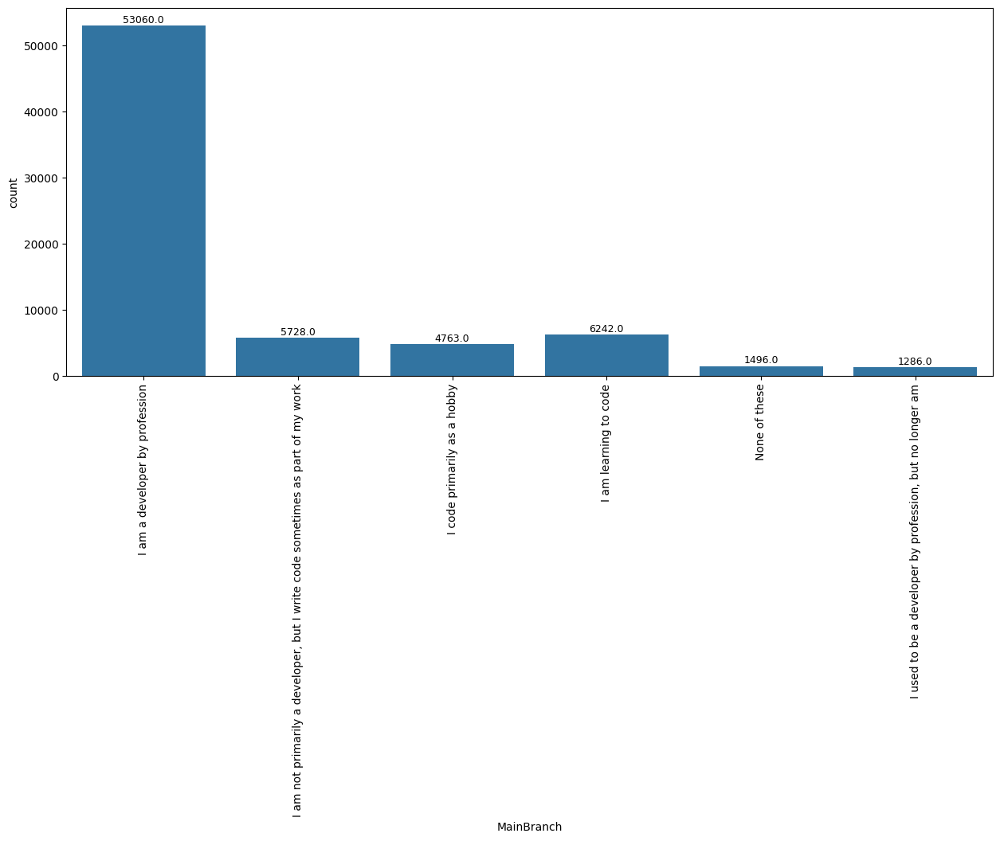

In [64]:
plt.figure(figsize = (15,6))

plt.xticks(rotation = 90)

ax = sns.countplot(x = new_df.MainBranch)

for p in ax.patches:
    ax.annotate(f'{p.get_height()}',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=9, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

In [65]:
employment_type_total

,0
"Employed, full-time",48808
"Student, full-time",10752
"Independent contractor, freelancer, or self-employed",10604
"Employed, part-time",4089
"Student, part-time",3672
"Not employed, but looking for work",3321
"Not employed, and not looking for work",1205
I prefer not to say,599
Retired,384


<Axes: xlabel='None', ylabel='None'>

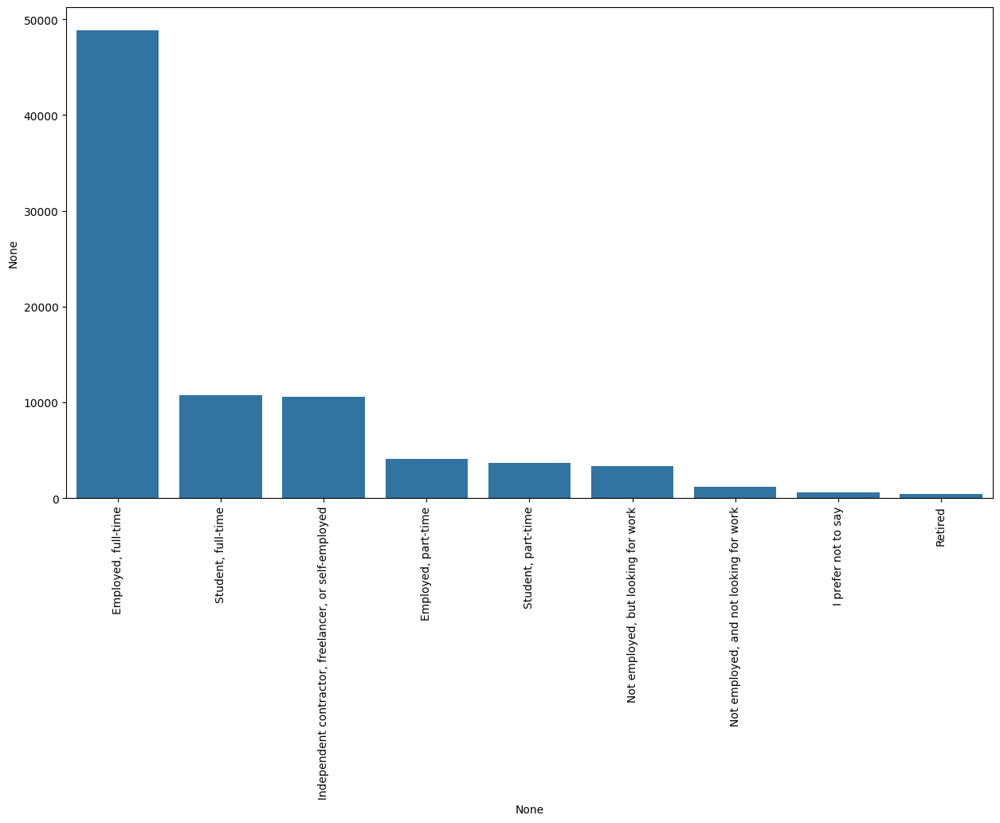

In [66]:
plt.figure(figsize = (15,8))

plt.xticks(rotation = 90)

sns.barplot(x = employment_type_total.index, y = employment_type_total)

In [67]:
new_df.RemoteWork.value_counts()

,count
RemoteWork,
Fully remote,25100
"Hybrid (some remote, some in-person)",24815
Full in-person,8538


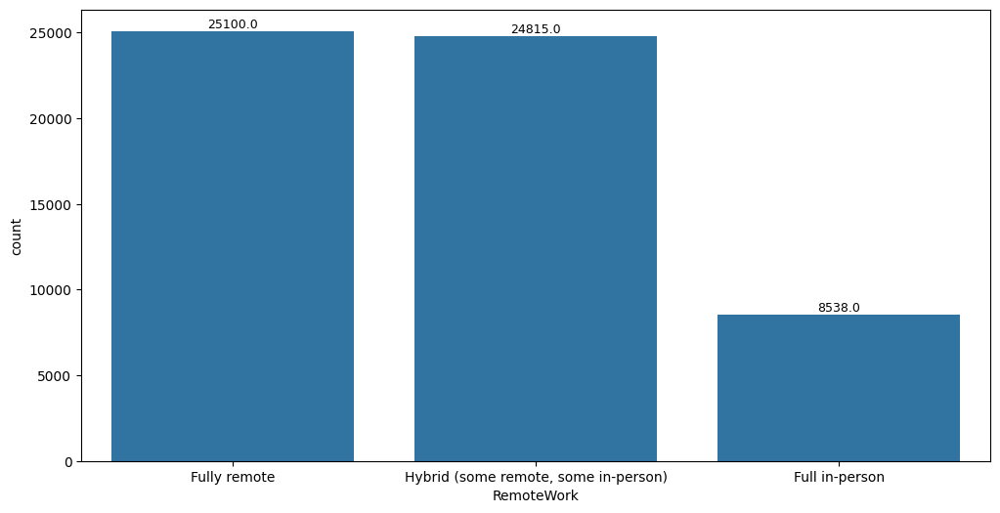

In [68]:
plt.figure(figsize = (12,6))

#plt.xticks(rotation = 90)

ax = sns.countplot(x = new_df.RemoteWork, order = new_df.RemoteWork.value_counts().index)

for p in ax.patches:
    ax.annotate(f'{p.get_height()}',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=9, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

<Axes: xlabel='EdLevel', ylabel='count'>

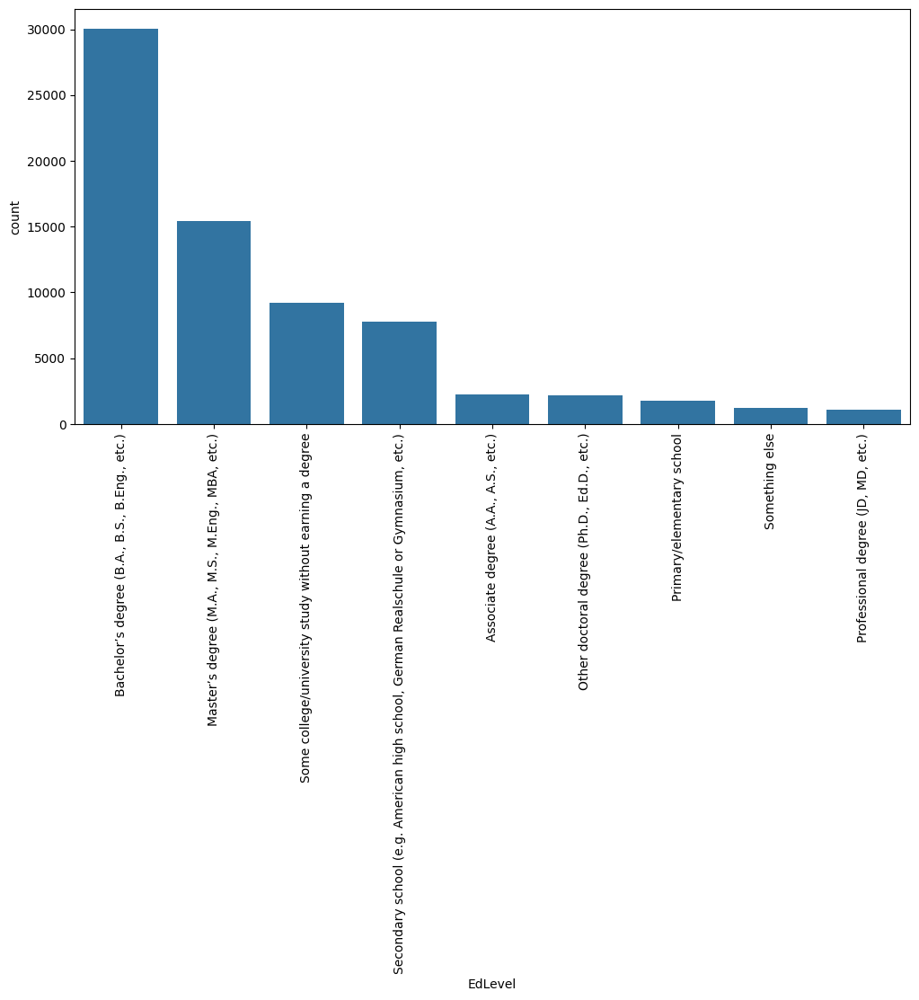

In [69]:
plt.figure(figsize = (12,6))
plt.xticks(rotation = 90)
sns.countplot(x = new_df.EdLevel, order = new_df.EdLevel.value_counts().index)


In [70]:
respondent_countries = new_df.Country.value_counts().sort_values(ascending = False).head(10)
respondent_countries

,count
Country,
United States of America,13321
India,6618
Germany,5342
United Kingdom of Great Britain and Northern Ireland,4132
Canada,2459
France,2306
Brazil,2088
Poland,1719
Netherlands,1539


<Axes: xlabel='Country', ylabel='count'>

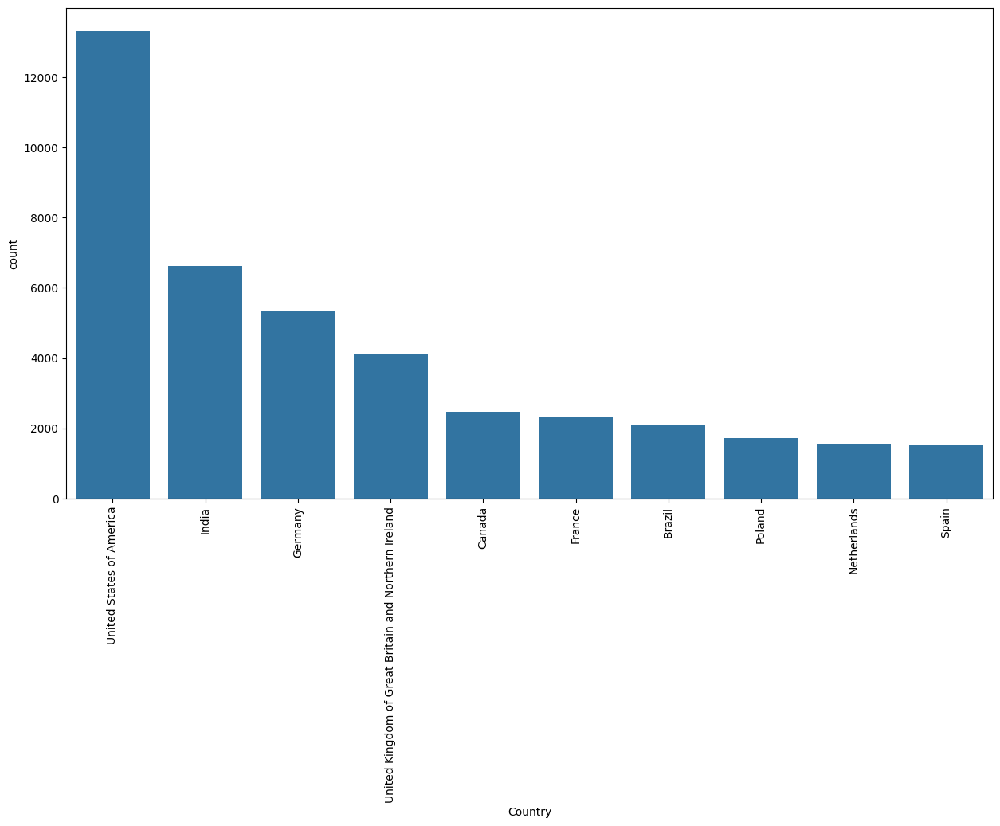

In [71]:
plt.figure(figsize = (15,8))

plt.xticks(rotation = 90)

sns.barplot(x = respondent_countries.index, y = respondent_countries)

In [72]:
new_df.Age

,Age
1,NaN
2,25-34 years old
3,35-44 years old
4,25-34 years old
5,25-34 years old
6,Under 18 years old
7,18-24 years old
8,25-34 years old
9,45-54 years old
10,18-24 years old


In [73]:
new_df.Age.value_counts()

,count
Age,
25-34 years old,27878
18-24 years old,16455
35-44 years old,13866
45-54 years old,5250
Under 18 years old,3775
55-64 years old,1974
65 years or older,547
Prefer not to say,512


In [74]:
age_count = new_df.Age.value_counts().sort_values(ascending = False)

age_count

,count
Age,
25-34 years old,27878
18-24 years old,16455
35-44 years old,13866
45-54 years old,5250
Under 18 years old,3775
55-64 years old,1974
65 years or older,547
Prefer not to say,512


<Axes: xlabel='Age', ylabel='count'>

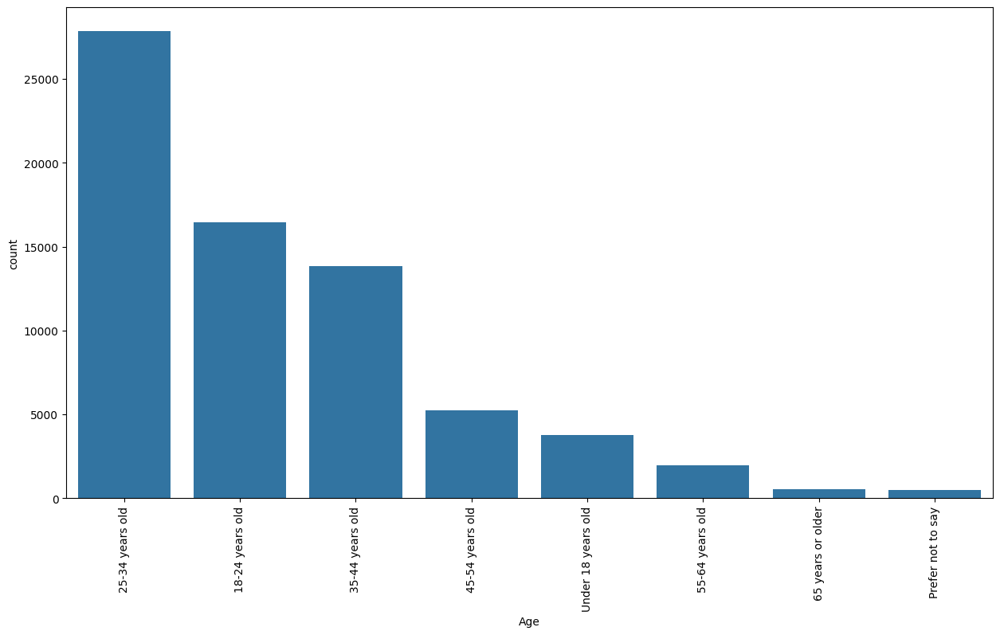

In [75]:
plt.figure(figsize = (15,8))

plt.xticks(rotation = 90)

sns.countplot( x = new_df.Age, order = new_df.Age.value_counts().index)

<Axes: xlabel='YearsCode', ylabel='Count'>

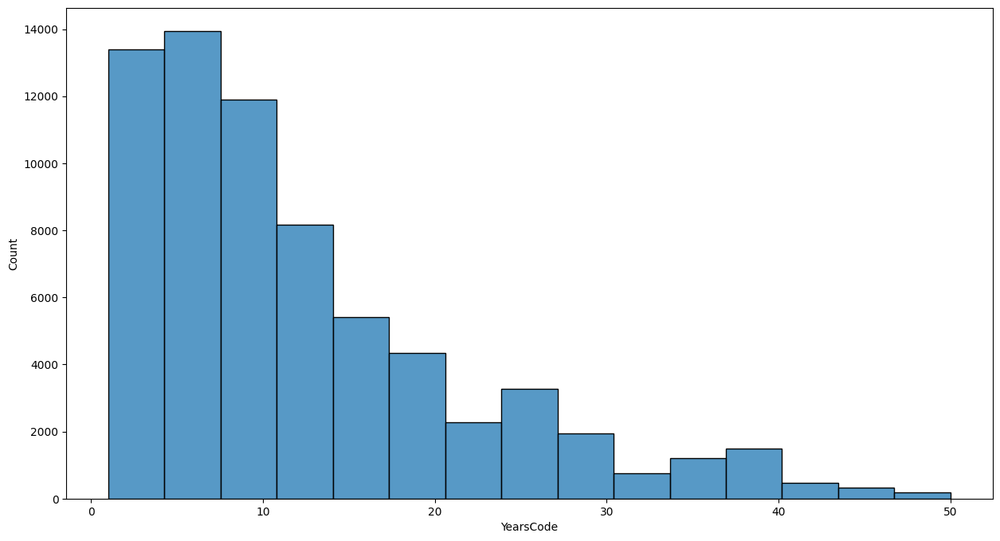

In [76]:
plt.figure(figsize = (15,8))

sns.histplot(new_df.YearsCode, bins = 15)

<Axes: xlabel='WorkExp', ylabel='Count'>

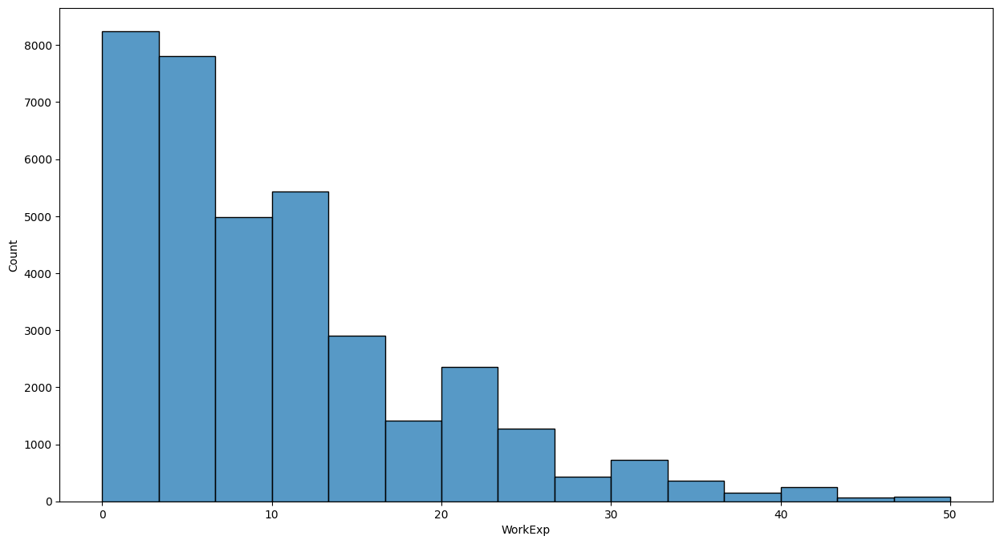

In [77]:
plt.figure(figsize = (15,8))

sns.histplot(new_df.WorkExp, bins = 15)

# Bivariate Analysis

In [78]:
new_df.columns

Index(['MainBranch', 'Employment', 'RemoteWork', 'CodingActivities', 'EdLevel',
       'LearnCode', 'LearnCodeOnline', 'LearnCodeCoursesCert', 'YearsCode',
       'YearsCodePro', 'DevType', 'OrgSize', 'PurchaseInfluence', 'BuyNewTool',
       'Country', 'Currency', 'CompTotal', 'CompFreq',
       'LanguageHaveWorkedWith', 'LanguageWantToWorkWith',
       'PlatformHaveWorkedWith', 'PlatformWantToWorkWith', 'NEWSOSites',
       'SOVisitFreq', 'SOAccount', 'SOPartFreq', 'SOComm', 'Age', 'Gender',
       'Trans', 'Sexuality', 'Ethnicity', 'Accessibility', 'MentalHealth',
       'TBranch', 'ICorPM', 'WorkExp', 'TimeSearching', 'TimeAnswering',
       'Onboarding', 'ProfessionalTech', 'ConvertedCompYearly'],
      dtype='object')

In [79]:
new_df.LanguageHaveWorkedWith

,LanguageHaveWorkedWith
1,JavaScript;TypeScript
2,C#;C++;HTML/CSS;JavaScript;Python
3,C#;JavaScript;SQL;TypeScript
4,C#;HTML/CSS;JavaScript;SQL;Swift;TypeScript
5,C++;Lua
6,C++;HTML/CSS;JavaScript;PHP;Python;TypeScript
7,C;C++;HTML/CSS;Java;JavaScript;SQL
8,NaN
9,Delphi;Java;Swift
10,Bash/Shell;C#;HTML/CSS;JavaScript;PowerShell;SQL


In [80]:
worked_lnguages = split_multicolumn(new_df.LanguageHaveWorkedWith)

In [81]:
worked_lnguages.head()

,JavaScript,TypeScript,C#,C++,HTML/CSS,Python,SQL,Swift,Lua,PHP,C,Java,Delphi,Bash/Shell,PowerShell,Rust,Elixir,Erlang,Ruby,R,Scala,VBA,Dart,Go,Kotlin,Groovy,MATLAB,Perl,Haskell,Julia,LISP,Assembly,F#,Clojure,APL,Crystal,Fortran,Objective-C,SAS,OCaml,Solidity,COBOL
1,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,True,False,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,True,True,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,True,True,True,False,True,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
5,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [82]:
wantto_lnguages = split_multicolumn(new_df.LanguageWantToWorkWith)

In [83]:
wantto_lnguages.head()

,Rust,TypeScript,C#,C++,HTML/CSS,JavaScript,SQL,Elixir,F#,Go,Lua,C,Java,Kotlin,Python,Swift,APL,Bash/Shell,Delphi,Haskell,Erlang,Ruby,Scala,PowerShell,VBA,Julia,PHP,Dart,Groovy,Perl,LISP,Clojure,Assembly,Solidity,R,Crystal,Objective-C,SAS,OCaml,MATLAB,Fortran,COBOL
1,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,True,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,True,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,True,True,True,False,False,True,False,True,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
5,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [84]:
worked_lnguages_count = worked_lnguages.sum().sort_values(ascending = False)

In [85]:
wantto_lnguages_count = wantto_lnguages.sum().sort_values(ascending = False)

In [86]:
comb_langs = pd.concat([worked_lnguages_count, wantto_lnguages_count], axis = 1)

comb_langs.columns = ['languages worked with', 'languages want to work with']

In [87]:
comb_langs.head()

,languages worked with,languages want to work with
JavaScript,45969,31235
HTML/CSS,38714,25130
SQL,34782,24579
Python,33772,29043
TypeScript,24470,25787


<Axes: >

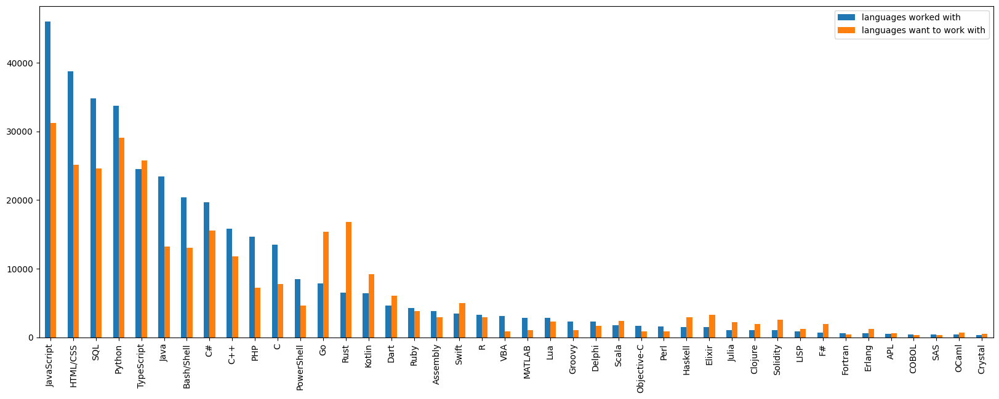

In [88]:
comb_langs.plot(kind = 'bar', figsize = (20,7))

In [89]:
new_df.PlatformHaveWorkedWith.value_counts()

,count
PlatformHaveWorkedWith,
AWS,8661
Microsoft Azure,4955
Google Cloud,2280
AWS;Microsoft Azure,2028
Heroku,1981
Firebase,1940
AWS;Google Cloud,1682
AWS;Heroku,1183
DigitalOcean,1113


In [90]:
worked_platforms = split_multicolumn(new_df.PlatformHaveWorkedWith)

In [91]:
worked_platforms.head()

,Firebase,Microsoft Azure,AWS,Google Cloud,Heroku,DigitalOcean,VMware,OVH,Linode,Managed Hosting,IBM Cloud or Watson,Oracle Cloud Infrastructure,OpenStack,Colocation
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,True,True,False,False,False,False,False,False,False,False,False,False,False,False
5,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [92]:
worked_platform_count = worked_platforms.sum().sort_values(ascending = False)

In [93]:
worked_platform_count

,0
AWS,25719
Microsoft Azure,14479
Google Cloud,13491
Firebase,10650
Heroku,10050
DigitalOcean,7848
VMware,4376
Managed Hosting,2877
Linode,1956
OVH,1886


In [94]:
wantto_platforms = split_multicolumn(new_df.PlatformWantToWorkWith)
wantto_platform_count = wantto_platforms.sum().sort_values(ascending = False)

In [95]:
wantto_platform_count

,0
AWS,23533
Google Cloud,13272
Microsoft Azure,12695
Firebase,8569
DigitalOcean,6887
Heroku,5888
VMware,2465
Linode,2220
Managed Hosting,1852
OpenStack,1349


In [96]:
comb_plats = pd.concat([worked_platform_count, wantto_platform_count], axis = 1)
comb_plats.columns = ["worked platforms", "want to work platforms"]

<Axes: >

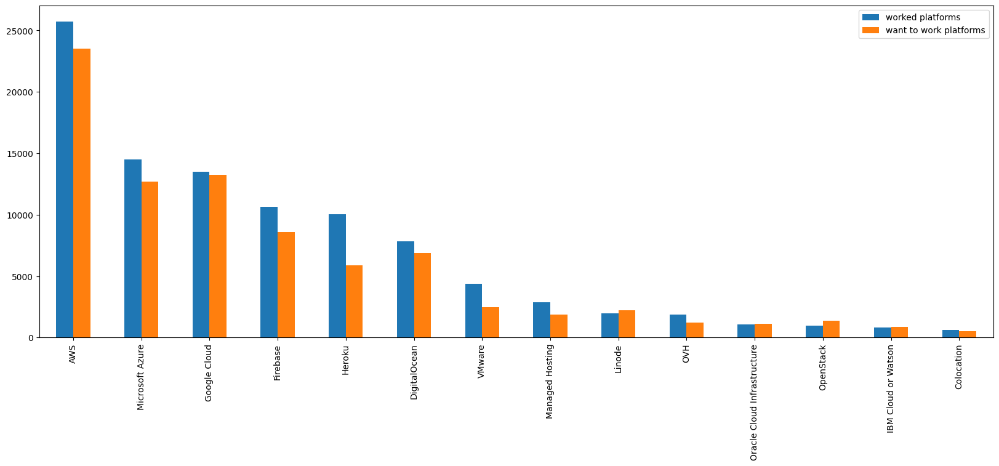

In [97]:
comb_plats.plot(kind = 'bar', figsize = (20,7))

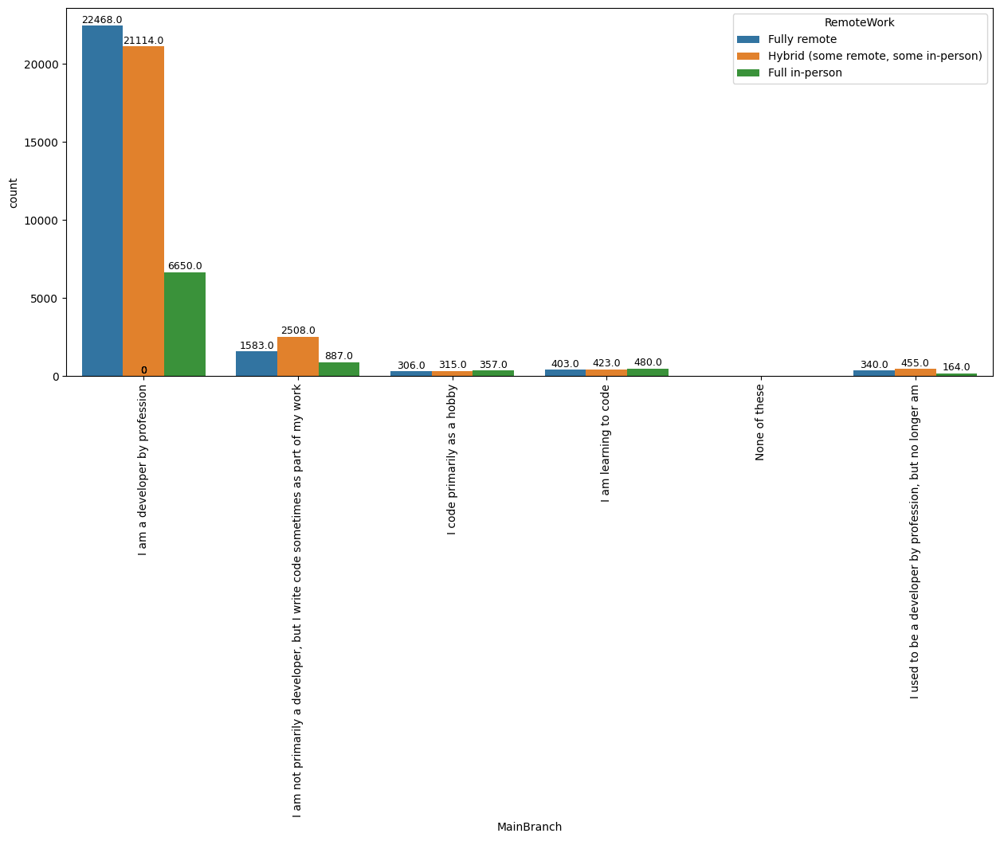

In [98]:
plt.figure(figsize = (15,6))

plt.xticks(rotation = 90)

ax = sns.countplot(x = new_df.MainBranch, hue = new_df.RemoteWork)

for p in ax.patches:
    ax.annotate(f'{p.get_height()}',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=9, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

<Axes: xlabel='EdLevel', ylabel='YearsCode'>

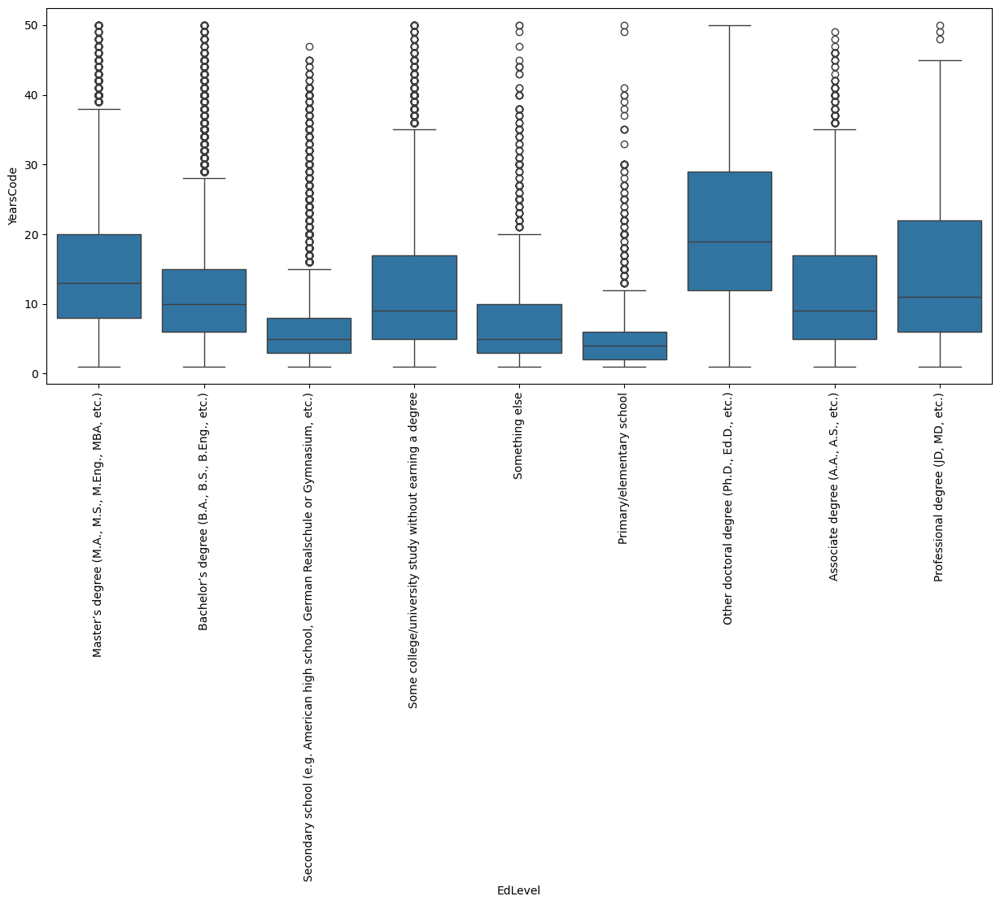

In [99]:
plt.figure(figsize = (15,6))

plt.xticks(rotation = 90)

sns.boxplot(x = new_df.EdLevel, y = new_df.YearsCode)

<Axes: xlabel='Gender', ylabel='YearsCodePro'>

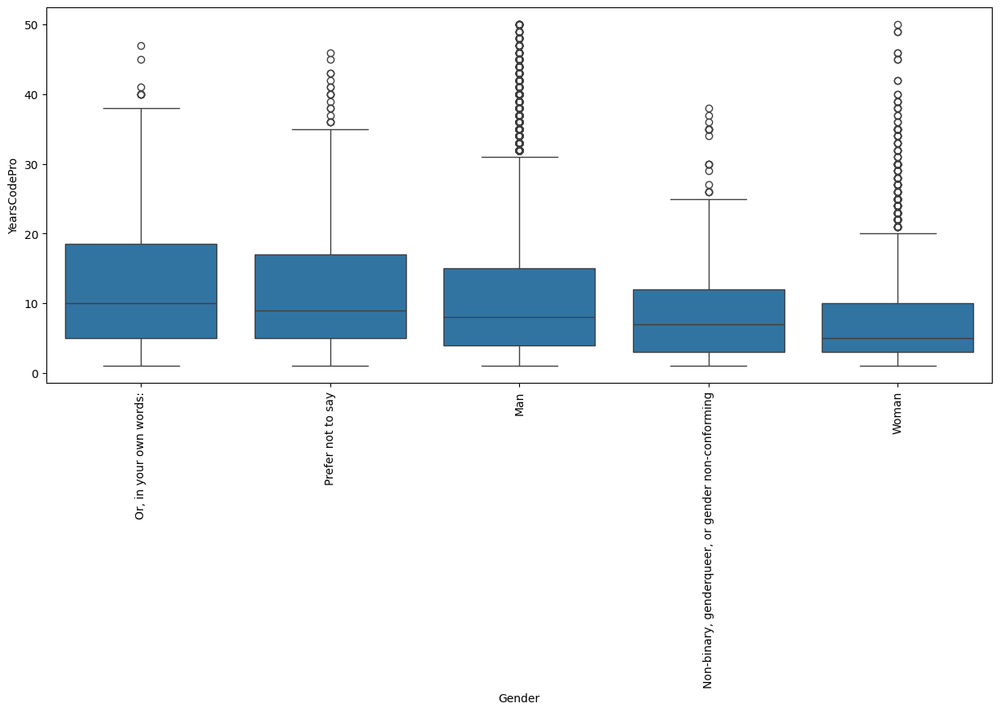

In [100]:
plt.figure(figsize = (15,6))

plt.xticks(rotation = 90)

iqr_per_gender = new_df.groupby('Gender')['YearsCodePro'].quantile(0.75) - new_df.groupby('Gender')['YearsCodePro'].quantile(0.25)

sorted_categories = iqr_per_gender.sort_values(ascending=False).index

sns.boxplot(x = new_df.Gender, y = new_df.YearsCodePro, order = sorted_categories)

In [101]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73267 entries, 1 to 73267
Data columns (total 42 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   MainBranch              72575 non-null  object 
 1   Employment              71020 non-null  object 
 2   RemoteWork              58453 non-null  object 
 3   CodingActivities        58392 non-null  object 
 4   EdLevel                 70879 non-null  object 
 5   LearnCode               70891 non-null  object 
 6   LearnCodeOnline         50168 non-null  object 
 7   LearnCodeCoursesCert    29169 non-null  object 
 8   YearsCode               69081 non-null  float64
 9   YearsCodePro            49433 non-null  float64
 10  DevType                 60761 non-null  object 
 11  OrgSize                 50643 non-null  object 
 12  PurchaseInfluence       50574 non-null  object 
 13  BuyNewTool              67304 non-null  object 
 14  Country                 71079 non-null

<Axes: xlabel='Gender', ylabel='WorkExp'>

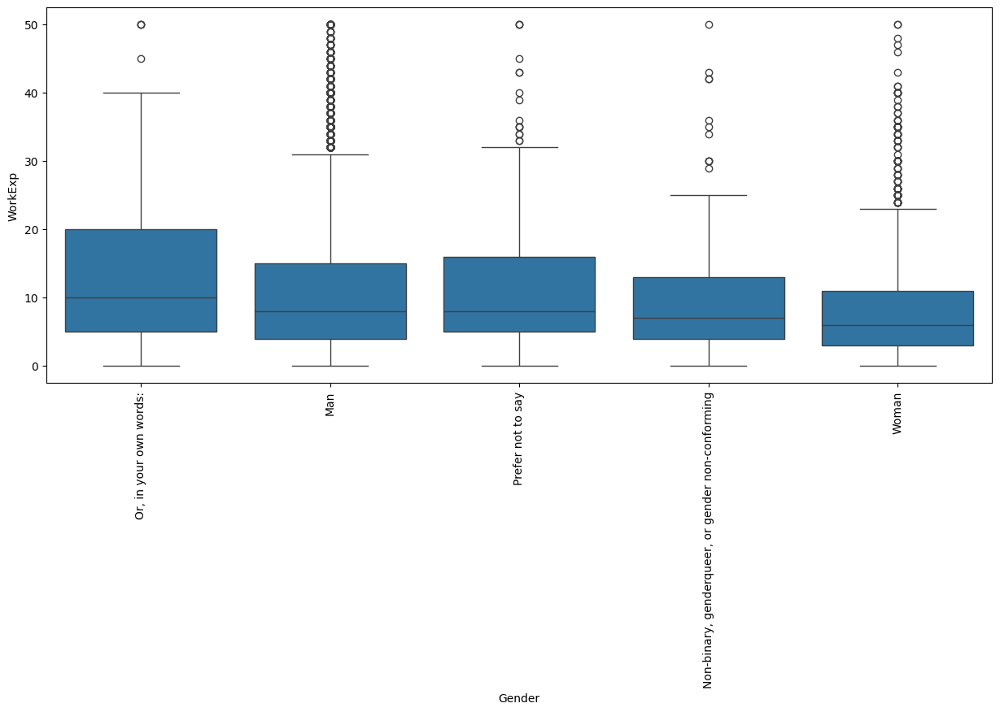

In [102]:
plt.figure(figsize = (15,6))

plt.xticks(rotation = 90)

iqr_per_gender = new_df.groupby('Gender')['WorkExp'].quantile(0.75) - new_df.groupby('Gender')['WorkExp'].quantile(0.25)

sorted_categories = iqr_per_gender.sort_values(ascending=False).index

sns.boxplot(x = new_df.Gender, y = new_df.WorkExp, order = sorted_categories)
